In [11]:
!pip install folium

In [42]:
import pandas as pd
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
import matplotlib.pyplot as plt

##### Carregamento de DF 

In [40]:
df = pd.read_csv(r"S:\GGMP\#COLETIVA\Ana Carolyne\PROJETO CIENCIA DE DADOS\cat_acidentes.csv", sep=";")
df = df.dropna(subset=['latitude', 'longitude'], how='any')
df['data'] = pd.to_datetime(df['data'], errors='coerce')
df_ano = df['data'].dt.year.value_counts()
df_ano = df_ano.drop(2202)
df_ano = df_ano.drop(2027)
df_ano = df_ano.drop(2026)
display(df_ano)

data
2023    14573
2024    13702
2022    13328
2021    11701
2025     4810
2020     2896
Name: count, dtype: int64

In [ ]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=12)
coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)
display(mapa)

In [32]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)
display(mapa)

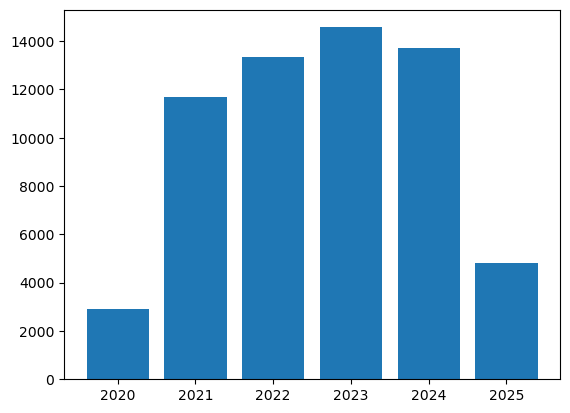

In [43]:
plt.bar(df_ano.index, df_ano.values)
plt.show()

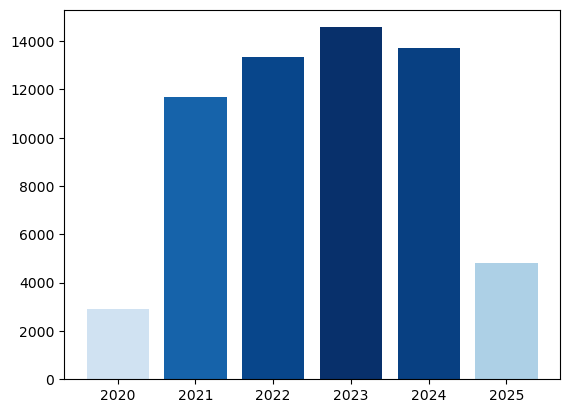

In [50]:
gradiente = df_ano/df_ano.max()
cores = plt.cm.Blues(gradiente)
plt.bar(df_ano.index, df_ano.values, color=cores)
plt.show()